# Imports

In [ ]:
%pip install scikeras

In [ ]:
 !pip install --no-cache-dir --extra-index-url https://pypi.nvidia.com 'cuml-cu11==23.10.*'

In [2]:
import cudf
from cuml.ensemble import RandomForestClassifier

In [ ]:
! git clone https://github.com/Xtra-Computing/thundersvm.git
! cd thundersvm && mkdir build && cd build && cmake .. && make -j
! python /content/thundersvm/python/setup.py install

In [3]:
from importlib.machinery import SourceFileLoader
thundersvm = SourceFileLoader("thundersvm", "/content/thundersvm/python/thundersvm/thundersvm.py").load_module()

In [4]:
import h5py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random
from scipy import signal
from scipy.ndimage import convolve
import json
import cv2
import seaborn as sns
from PIL import Image
import time

import sklearn
from sklearn.decomposition import PCA, IncrementalPCA
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler
#from sklearn.svm import SVC
from thundersvm import SVC
from sklearn.ensemble import RandomForestClassifier

from skimage import io, color
from skimage.filters import threshold_otsu, gaussian
from skimage.exposure import equalize_adapthist
from skimage.morphology import binary_closing, binary_dilation, square, disk
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.feature import hog, blob_doh
from skimage.transform import rescale, rotate


from torch import nn
import torchvision.models as models
from torchvision import transforms

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam, SGD
from scikeras.wrappers import KerasClassifier
from tensorflow.keras.utils import to_categorical
from keras.regularizers import l1, l2

# Constant Variables

In [5]:
random_state = 1243
held_out_test_set_portion = 0.2
validation_set_portion = 0.3

# PCA configurations from PCA Analysis
components_dict = {'Mean Color Channel': 3,'Center Color Channel': 3, 'HOG': 395, 'BOVW':190, "ResNet":150}

# Data Loading & Label Defining

In [ ]:
import requests

url = 'https://www.astro.utoronto.ca/~hleung/shared/Galaxy10/Galaxy10_DECals.h5'
file_name = url.split('/')[-1]

# Download the file
response = requests.get(url)
if response.status_code == 200:
    with open(file_name, 'wb') as file:
        file.write(response.content)
    print(f"File '{file_name}' downloaded successfully.")
else:
    print(f"Failed to download the file. Status code: {response.status_code}")

File 'Galaxy10_DECals.h5' downloaded successfully.


In [56]:
# To get the images and labels from file
with h5py.File('Galaxy10_DECals.h5', 'r') as F:
    images = np.array(F['images'])
    labels = np.array(F['ans'])

# To convert to desirable type
labels = labels.astype(np.float32)
images = images.astype(np.float32)

In [6]:
## Label Dictionary

# Galaxy10 dataset (17736 images)
#├── Class 0 (1081 images): Disturbed Galaxies
#├── Class 1 (1853 images): Merging Galaxies
#├── Class 2 (2645 images): Round Smooth Galaxies
#├── Class 3 (2027 images): In-between Round Smooth Galaxies
#├── Class 4 ( 334 images): Cigar Shaped Smooth Galaxies
#├── Class 5 (2043 images): Barred Spiral Galaxies
#├── Class 6 (1829 images): Unbarred Tight Spiral Galaxies
#├── Class 7 (2628 images): Unbarred Loose Spiral Galaxies
#├── Class 8 (1423 images): Edge-on Galaxies without Bulge
#└── Class 9 (1873 images): Edge-on Galaxies with Bulge"""

label_dict = {0: 'Disturbed Galaxies',
              1: 'Merging Galaxies',
              2: 'Round Smooth Galaxies',
              3: 'In-between Round Smooth Galaxies',
              4: 'Cigar Shaped Smooth Galaxies',
              5: 'Barred Spiral Galaxies',
              6: 'Unbarred Tight Spiral Galaxies',
              7: 'Unbarred Loose Spiral Galaxies',
              8: 'Edge-on Galaxies without Bulge',
              9: 'Edge-on Galaxies with Bulge'
}

In [ ]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 7792738537563118135
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 13854638080
locality {
  bus_id: 1
  links {
  }
}
incarnation: 9454697819744590497
physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
xla_global_id: 416903419
]


# Preprocessing Functions

In [7]:
## Util Functions For EDA and plotting
def get_colorchannel(color, imgs):
    """Returns Specified Color Channel on input list of images,
    color channels are g, r, z (or G, R, Z)"""
    if color in "GRVgrv":
        if color in 'Gg':
            return imgs[:,:,:,0]
        elif color in 'Rr':
            return imgs[:,:,:,1]
        else:
            return imgs[:,:,:,2]

def get_gtype(gtype, imgs, lbls):
    """Returns list of images in specific Galaxy type given the number label of the Galaxy.
    See Dictionary Mapping table above for Galaxy types and corresponding numbers"""
    indicies = np.argwhere(lbls == gtype).flatten()
    print(indicies)
    return imgs[list(indicies)]


def plot_galaxy(g_ims, title):
    "Plots Galaxy images"
    n = len(g_ims)
    fig, axs = plt.subplots(1, n, figsize = (16,3))
    #plt.sgtitle(title)
    for i in range(n):
        axs[i].imshow(g_ims[i]/255, cmap = 'hsv')
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()

def plot_galaxy_bw(g_ims, title):
    "Plots Galaxy images"
    n = len(g_ims)
    fig, axs = plt.subplots(1, n, figsize = (16,3))
    #plt.sgtitle(title)
    for i in range(n):
        axs[i].imshow(g_ims[i]/255, cmap = 'gray')
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()

In [8]:
## Image Rescaling, Grayscale, and Normalizing

def create_2d_gaussian(size=9, std=1.5):
    """ create a 2-D gaussian blurr filter for a given mean and std """
    gaussian_1d = signal.gaussian(size,std=std)
    gaussian_2d = np.outer(gaussian_1d, gaussian_1d)
    gaussian_2d = gaussian_2d/(gaussian_2d.sum())
    return gaussian_2d

def normalize_img(img):
    """ normalize teh image between 0 and 1 """
    normalized = (img - img.min())/(img.max() - img.min())
    return normalized

def rescale_image_cc(img, filt_size = 9, blur = False):
    """Rescales full 3 color chanel image with option to add a gaussian blur"""
    standard = img.shape[0]
    center = np.array(img.shape) // 2
    img = img[center[0] - standard//4:center[0] + standard//4, center[1] - standard//4:center[1] + standard//4]
    if blur == True:
        g = create_2d_gaussian(12, 12)
        img = img[center[0] - standard//4:center[0] + standard//4, center[1] - standard//4:center[1] + standard//4]
        imd1 = convolve(img[:,:,0], g, mode = 'wrap')
        imd2 = convolve(img[:,:,1], g, mode = 'wrap')
        imd3 = convolve(img[:,:,2], g, mode = 'wrap')
        img = np.dstack([imd2,imd1, imd3])
    return img

def rescale_image_bw(img, filt_size = 9, blur = False):
    standard = img.shape[0]
    center = np.array(img.shape) // 2
    img = img[center[0] - standard//4:center[0] + standard//4, center[1] - standard//4:center[1] + standard//4]
    if blur == True:
        g = create_2d_gaussian(9, 3)
        img = convolve(img, g, mode = 'wrap')
    return img

def convert_gray(imgs):
    """Converts a list of images into grayscale"""
    return np.array([cv2.cvtColor(np.dstack([im[:, :, 1], im[:, :, 0], im[:, :, 2]]).astype('float32'),cv2.COLOR_RGB2GRAY).astype('uint8') for im in imgs])

In [9]:
def random_sampling_inpaint(image, mask, exclusion_mask):
    mask = mask.astype(bool)
    exclusion_mask = exclusion_mask.astype(bool)
    # get coords
    non_star_coords = np.argwhere(~mask & ~exclusion_mask)
    if len(non_star_coords) == 0:
        return image
    # inpaint
    inpainted_image = np.copy(image)
    star_coords = np.argwhere(mask)
    for star_coord in star_coords:
        random_choice = non_star_coords[np.random.choice(len(non_star_coords))]
        inpainted_image[tuple(star_coord)] = image[tuple(random_choice)]

    return inpainted_image


def background_subtraction(image):
    # convert to 8-bit and grayscale
    image_8bit = image.astype(np.uint8)
    gray_image = color.rgb2gray(image_8bit)
    # blur and contrast
    blurred = gaussian(gray_image, sigma=2)
    clipped = np.clip(blurred, 0, 1)
    contrast_enhanced = equalize_adapthist(clipped)
    # binary image
    binary_threshold = threshold_otsu(contrast_enhanced)
    lowered_threshold = binary_threshold * 0.8
    binary_image = contrast_enhanced > lowered_threshold
    # clean and label
    cleaned_binary_image = binary_closing(binary_image, square(3))
    cleaned_binary_image = binary_dilation(cleaned_binary_image, square(1))
    labeled_image = label(cleaned_binary_image)
    # find the central blob
    regions = regionprops(labeled_image)
    center_x, center_y = np.array(labeled_image.shape) // 2
    central_region = (center_x - 10, center_y - 10, center_x + 10, center_y + 10)
    for region in regions:
        minr, minc, maxr, maxc = region.bbox
        if (minr < central_region[2] and maxr > central_region[0] and
            minc < central_region[3] and maxc > central_region[1]):
            central_blob = region
            break
    # create mask and dilate
    inpainting_mask = np.zeros_like(gray_image, dtype=bool)
    for region in regions:
        if region.label != central_blob.label:
            inpainting_mask[labeled_image == region.label] = True
    inpainting_mask = binary_dilation(inpainting_mask, disk(3))
    # create an exclusion mask for the central blob
    exclusion_mask = np.zeros_like(gray_image, dtype=bool)
    minr, minc, maxr, maxc = central_blob.bbox
    exclusion_mask[minr:maxr, minc:maxc] = True
    # apply inpainting
    image_inpainted = random_sampling_inpaint(image_8bit, inpainting_mask, exclusion_mask) if np.any(inpainting_mask) else image_8bit
    return image_inpainted


# Feature Extraction Functions

In [10]:
## Laplacian/Gaussian Stack Building and Visualization

def visualize_stack(in_stack, title):
    # set the number of levels
    # create multi-row figure
    # add images to the figure from the stack
    # don't forget to set the cmap, vmin, vmax, and axis off
    # add titles to the plot
    n = len(in_stack)
    fig, axs = plt.subplots(1, n, figsize = (16,3))
    #plt.sgtitle(title)
    for i in range(n):
        axs[i].imshow(in_stack[i], cmap = 'gray', vmin = np.min(in_stack[i]), vmax = np.max(in_stack[i]))
        axs[i].set_title(f"Level {i+1}")
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()

# takes in a single channel
def gaussian_and_laplacian_stack(img, levels):
    # create 2D Gaussian
    # for each level
    # apply Gaussian and append to Gaussian stack
    # subtract current from previous Gaussian in stack
    # append result to Laplacian stack
    g = create_2d_gaussian(9, 5)
    g_stack = [img]
    l_stack = []
    for level in range(levels - 1):
        g_img = convolve(img, g, mode = 'wrap')
        l_img = img - g_img
        g_stack.append(g_img)
        l_stack.append(l_img)
        img = g_img
    l_stack.append(img)
    return np.array(g_stack), np.array(l_stack)

def laplacian_stack(img, levels):
    # create 2D Gaussian
    # for each level
    # apply Gaussian and append to Gaussian stack
    # subtract current from previous Gaussian in stack
    # append result to Laplacian stack
    g = create_2d_gaussian(9, 9)
    l_stack = [img]
    for level in range(levels - 1):
        g_img = convolve(img, g, mode = 'wrap')
        l_img = img - g_img
        l_stack.append(l_img)
        img = g_img
    l_stack.append(img)
    return np.array(l_stack)

In [11]:
## Blob Detection

def detect_blob(im):
    "Detects Blob for an image and returns a list of the x location, y location, and radius of the blob in the image"
    blb_img = im/255

    # Calculating Difference of Hessians
    #blob_log_r = blob_doh(im[:,:,0], threshold_rel = .1, min_sigma = 10, max_sigma = 30)
    #blob_log_g = blob_doh(im[:,:,1], threshold_rel = .1, min_sigma = 10, max_sigma = 30)
    blob_log_z = blob_doh(im[:,:,1], threshold_rel = .1, min_sigma = 10, max_sigma = 30)

    #blob_log = np.concatenate((blob_log_r, blob_log_g, blob_log_z), axis = 0)

    # Create a DataFrame from the data
    blob_df = pd.DataFrame(blob_log_z, columns=['x', 'y', 'r'])

    # Use groupby to find the maximum radius for each (x, y) group
    blob_result = blob_df.groupby(['x', 'y'])['r'].max().reset_index()
    # blob_result = blob_df.groupby(['x', 'y'])['r'].count().loc[lambda x: x>1].reset_index()

    # Convert the result to a 2D NumPy array
    blob_log = blob_result.to_numpy()

    # Compute radii in the 3rd column to create blobs
    blob_log[:, 2] = blob_log[:, 2] * np.sqrt(2)

    return blob_log


def detect_blob_bw(im):
    "Detects Blob for a grayscale image and returns a list of the x location, y location, and radius of the blob in the image"

    # Calculating Difference of Hessians
    blob_log = blob_doh(im, threshold_rel = .1, min_sigma = 10, max_sigma = 30)

    # Find the index of the maximum value in the third column
    max_index = np.argmax(my_array[:, -1])

    # Getting the subarray array with the largest radius
    blob_result = blob_log[max_index]

    # Convert the result to a 2D NumPy array
    blob_log = blob_result.to_numpy()

    # Compute radii in the 3rd column to create blobs
    blob_log[:, 2] = blob_log[:, 2] * np.sqrt(2)

    return blob_log


def plot_blob(im, blb_log, title = 'Blob Detection', cmap = 'hsv'):
    'Plots Detected Blobs'
    # Setting Axis for plotting
    fig, ax = plt.subplots(figsize=(9, 3))
    im = im/255

    # Plotting original image
    ax.set_title(title)
    ax.imshow(im, cmap = cmap)

    # Loop through the detected blobs and plot them on the image
    for i in range(len(blb_log)):
        y, x, r = blb_log[i, 0], blb_log[i, 1], blb_log[i, 2]
        c = plt.Circle((x, y), r, color='red', linewidth=2, fill=False)
        ax.add_patch(c)


In [12]:
## HOG Feature Extraction and Visualization

def get_hog_features(imgs):
    """Generates Hog Feature Vectors for images. Input should be a list or array of either black and white
    or single color channel images, returns an array of the hog features for those images"""
    hog_features_f = []
    for im in imgs:
        bw_im_processed = rescale_image_bw(im)
        f, h = hog(bw_im_processed, orientations=6, pixels_per_cell=(8, 8), visualize=True)
        hog_features_f.append(f)
    return hog_features_f

def get_hog_features_and_histograms(imgs):
    """Generates Hog Feature Vectors for images. Input should be a list or array of either black and white
    or single color channel images, returns an array of the hog features for those images"""
    hog_features_f = []
    hog_hists = []
    for im in imgs:
        bw_im_processed = rescale_image_bw(im)
        f, h = hog(bw_im_processed, orientations=6, pixels_per_cell=(8, 8), visualize=True)
        hog_features_f.append(f)
        hog_hists.append(h)
    return hog_features_f, hog_hists


def plot_hog_feature_vector(feature_list, label_list):
    """Plots hog feature Vectors, input should be a list of Hog Feature Vectors and an associated list of labels"""
    plt.figure(figsize=(10, 5))
    for i in np.unique(label_list):
        indicies = np.argwhere(label_list == i)
        class_featues = feature_list[indicies]
        mean_features = np.mean(class_features, axis = 0)
        for f in features:
            plt.plot(mean_features, alpha=0.25)
    plt.title("Mean HOG Feature Vector Plot")
    plt.xlabel("Mean Feature Position Index")
    plt.ylabel("Mean Feature Value")
    plt.legend([str(clss) for clss in np.unique(label_list)])
    plt.show()

def plot_hog_histograms(image_list, label_list, histogram_list):
    """Plots hog Histograms as generated from images, alongside the original image"""
    fig, ax = plt.subplots(nrows=len(image_list), ncols=2, figsize=(10,40))
    for i in range(len(image_list)):
        ax[i, 0].imshow(image_list[i]/255, cmap='hsv', vmin=0, vmax=1)
        ax[i, 1].imshow(10*h, cmap='gray', vmin=0, vmax=0.5)
        ax[i, 0].set_title(f"{label_dict[i]} HOG")
        ax[i, 0].axis('off')
        ax[i, 1].axis('off')
    plt.tight_layout()
    plt.show()


In [13]:
## Color Channel Extraction

def extract_mean_colors(color_imgs):
    """Extracts the mean color from the main portion of the galaxy image, returns a list with the mean of each color channel
    for each image"""
    mean_colors= []
    for img in color_imgs:
            center = np.array(img.shape) // 2
            img = img[center[0] - 256//4:center[0] + 256//4, center[1] - 256//4:center[1] + 256//4]
            means = [np.mean(img[:,:, 0]), np.mean(img[:,:, 1]), np.mean(img[:,:, 2])]
            mean_colors += [means]
    return mean_colors


def extract_center_color(color_imgs):
    """Extracts the central color channels from the image"""
    center_colors = []
    for img in color_imgs:
        center = np.array(img.shape) // 2
        mc = img[center[0], center[1], :]
        center_colors+=[mc]
    return center_colors

def plot_mean_and_center_color_channels(mean_channels, labels):
    fig, ax = plt.subplots(1, 3, figsize=(24, 8))
    sns.kdeplot(data = [mean_channels[:, 0], labels], ax = ax[0])
    sns.kdeplot(data = [mean_channels[:, 1], labels], ax = ax[1])
    sns.kdeplot(data = [mean_channels[:, 2], labels], ax = ax[2])
    ax[0].set_title("Mean Green Color Channel")
    ax[1].set_title("Mean Red Color Channel")
    ax[2].set_title("Mean Infrared Color Channel")
    ax[0].get_legend().set_visible(False)
    ax[1].get_legend().set_visible(False)
    ax[2].get_legend().set_visible(False)
    fig.legend(label_dict.values())

In [14]:
# Bag of Words (BoW) Feature Functions
def visual_bow_kp_descriptors(images, desc_size = 25):
    """Extracts visual Bag of words features, input must be black and white images"""
    sift_descriptors = []
    sift_kp = []
    for im in images:
        sift = cv2.SIFT_create()
        keypoints, descriptors = sift.detectAndCompute(convert_gray([im])[0], None)
        if descriptors is None:
            sift_descriptors.append(np.zeros((desc_size, len(im))).astype('float32'))
            continue
        else:
            descriptors = descriptors[np.random.randint(len(descriptors), size = 25)]
            sift_descriptors.append(descriptors)
            sift_kp.append(keypoints)
    all_descriptors = np.array(sift_descriptors).reshape(len(sift_descriptors)*desc_size, 128)
    return sift_kp, sift_descriptors, all_descriptors

def get_bovw_codebook(all_descriptors, num_clusters = 200):
    """Generates Codebook given an input of all sift descriptors from the training set"""
    kmeans = KMeans(n_clusters =  num_clusters)
    bovw_codebook = kmeans.fit(all_descriptors)
    return bovw_codebook

def get_bow_feature_vector(codebook_kmeans, sift_descriptors, num_clusters = 200):
    histo_list = []
    for d in sift_descriptors:
        histo_list.append(codebook_kmeans.predict(d))

    frequency_vectors = []
    for visual_words in histo_list:
        # create a frequency vector for each image
        frequency_vector = np.zeros(num_clusters)
        for word in visual_words:
            frequency_vector[word] += 1
        frequency_vectors.append(frequency_vector)
    # stack together in numpy array
    frequency_vectors = np.stack(frequency_vectors)

    N = len(sift_descriptors)

    # df is the number of images that a visual word appears in
    df = np.sum(frequency_vectors > 0, axis=0)
    idf = np.log(N/ df)
    tf_idf = frequency_vectors * idf
    return tf_idf

In [15]:
# Resnet Feature Functions
def prep_ims(imags, preprocess):
    #gray_ims = convert_gray(images)
    #print(gray_ims)
    return np.array([preprocess(Image.fromarray(im.astype('uint8'))).numpy() for im in imags])

def prep_im(im, preprocess):
    return preprocess(Image.fromarray(im.astype('uint8')))

def get_resnet_features(images):
    resnet101 = models.resnet101(pretrained=True)

    model_conv_features = nn.Sequential(*list(resnet101.children())[None:-1]).to('cpu')

    # pre-processing required by ResNet
    preprocess = transforms.Compose([transforms.CenterCrop(224),
                                    transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),])

    resnet101.eval()

    return np.array([model_conv_features(prep_im(im, preprocess).unsqueeze(0).to('cpu')).squeeze().detach().numpy() for im in images])

In [16]:
# Build Features as Input Dataset
def build_feature_vector(list_of_feature_arrays):
    """Given a list of arrays of different features (each index associated with an image across channels), concatenates features together for each
    image to create a final feature vector. each unique feature vector must be a 2-d array with a row of features for each image... i.e
    shape = (length of images in train/test/validation set, num features in featureset)"""
    return np.concatenate(list_of_feature_arrays, axis = -1)

def get_features(data):
    """
    Helper function to collect all features generated and put them in to dataset
    """
    mean_colors = extract_mean_colors(data)
    center_colors = extract_center_color(data)
    hog = get_hog_features(convert_gray(data))
    bovw_sift_desc, bovw_all_desc = visual_bow_kp_descriptors(X_train, desc_size = 25)[1:]
    codebook = get_bovw_codebook(bovw_all_desc)
    train_bovw = get_bow_feature_vector(codebook, bovw_sift_desc, 200)
    bovw = get_bow_feature_vector(codebook, visual_bow_kp_descriptors(data)[1])
    resnet = get_resnet_features(data)
    features = [mean_colors, center_colors, hog, bovw, resnet]
    labels = ['Mean Color Channel','Center Color Channel', 'HOG', 'BOVW', "ResNet"]
    return features, labels

def select_features(features, labels, selected_labels=[]):
    """
    Helper function to select only wanted features from a full list of features
    Input must come from the get_features function above.

    If use default option (selected_labels being empty list), will output all features without selection.
    """
    if not set(selected_labels).issubset(set(labels)):
        print(selected_labels)
        print(labels)
        raise ValueError("Selected labels must be a subset of available labels.")

    if len(selected_labels) == 0:
        return features

    selected_features = [feature for feature, label in zip(features, labels) if label in selected_labels]
    return selected_features


# Train Test Split & Undersampling

In [57]:
# undersampling
u_images = []
u_labels = []
for clss in np.unique(labels):
    inds= np.argwhere(labels == clss)[:334].flatten()
    u_labels.append(labels[inds])
    u_images.append(images[inds])
u_images = np.array(u_images).reshape([3340, images[0].shape[0], images[0].shape[1], 3])
u_labels = np.array(u_labels).reshape(3340)

In [58]:
# perform background substraction
for image in enumerate(u_images):
    u_images[image[0]] = background_subtraction(image[1])

In [59]:
# train test split
# test set will be held out of the training at all times.
# validation set will be splitted at the time of model training.
X_train, X_test, y_train, y_test = train_test_split(u_images,
                                                    u_labels,
                                                    stratify = u_labels,
                                                    train_size = 1-held_out_test_set_portion,
                                                    test_size = held_out_test_set_portion,
                                                    random_state = random_state)

In [60]:
# reset temp dataset so that it's not mis-used
u_images = 0
u_labels = 0

In [62]:
np.savez('processed_data.npz', X_train=X_train,
         X_test=X_test, y_train=y_train,y_test=y_test)

In [63]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((2672, 256, 256, 3), (668, 256, 256, 3), (2672,), (668,))

# Feature Selection & Build PCA Vectors Functions

In [73]:
def train_val_split(X_init, y_init,
                    rand_state = random_state,
                    val_size = validation_set_portion):
    """
    Function to split initial training set to train/validation set.
    rand_state and validation set proportion is set on top,
    in constants variable section.
    """
    X_train, X_val, y_train, y_val = train_test_split(X_init, y_init,
                                                      test_size=val_size, random_state=rand_state)

    train_features, feature_labels = get_features(X_train)
    val_features, feature_labels = get_features(X_val)

    return [train_features, y_train], [val_features, y_val], feature_labels

def get_X_val(X_init, y_init,
                    rand_state = random_state,
                    val_size = validation_set_portion):
    X_train, X_val, y_train, y_val = train_test_split(X_init, y_init,
                                                      test_size=val_size, random_state=rand_state)
    return X_val, y_val

def transform_to_PCA_vectors(all_train_features,
                             all_val_features,
                             all_feature_labels,
                             selected_labels,
                             components_dict = components_dict):
    """
    Function to select features according to components_dict specifications,
    and then output corresponding PCA vectors for model training.

    Example components_dict: {'Mean Color Channel': 3,
                              'Center Color Channel': 3,
                              'HOG': 395,
                              'BOVW': 190,
                              'Resnet': 150}
    """

    X_pca= []
    X_fit_pca_list = []
    X_train_transformed_features = []
    X_val_transformed_features = []

    train_features = select_features(all_train_features, all_feature_labels,
                                     selected_labels=selected_labels)
    val_features = select_features(all_val_features, all_feature_labels,
                                     selected_labels=selected_labels)

    if len(selected_labels) == 0:
        selected_labels = list(components_dict.keys())
    for i in range(len(selected_labels)):
        pca_ = PCA(n_components = components_dict[selected_labels[i]])
        train_fit_pca = pca_.fit(train_features[i])
        train_transformed_vect = train_fit_pca.transform(train_features[i])
        val_transformed_vect = train_fit_pca.transform(val_features[i])
        X_pca.append(pca_)
        X_fit_pca_list.append(train_fit_pca)
        X_train_transformed_features.append(train_transformed_vect)
        X_val_transformed_features.append(val_transformed_vect)

    # build vectors
    X_train_transformed_features = build_feature_vector(X_train_transformed_features)
    X_val_transformed_features = build_feature_vector(X_val_transformed_features)

    # standarize
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_transformed_features)
    X_val_scaled = scaler.transform(X_val_transformed_features)

    return scaler, X_train_scaled, X_val_scaled, X_pca, X_fit_pca_list

In [88]:
X_val, y_val = get_X_val(X_train, y_train)

In [60]:
# train validation split
train_set, val_set, feature_labels = train_val_split(X_train, y_train)
train_features, y_train = train_set
val_features, y_val = val_set


In [37]:
# convert to PCA and standarize
scaler, X_train_scaled, X_val_scaled, X_pca, X_fit_pca_list = transform_to_PCA_vectors(train_features, val_features,
                                                        feature_labels, ['Mean Color Channel', 'Center Color Channel', 'ResNet'])

In [26]:
np.savez('futher_processed_train.npz',
         *train_features)
np.savez('futher_processed_val.npz',
         *val_features)
np.savez('futher_processed_y_train.npz',
         *y_train)
np.savez('futher_processed_y_val.npz',
         *y_val)

# Model Training and Grid Search Functions

In [18]:
def grid_search(data, labels, model_type='LogReg', rand_state = random_state, cnn_x=19, cnn_y=39):

    # load data
    X_train_scaled, X_val_scaled = data
    y_train, y_val = labels

    # build grid for each model type
    if model_type == 'LogReg':
        param_grid = {
            'model__optimizer': [SGD(learning_rate=0.01), Adam(learning_rate=0.01)],
            'model__kernel_regularizer': [l1(0.01), l2(0.01)],
            'epochs': [100, 200]
        }
        model = KerasClassifier(model=create_logreg_model,
                                input_dim=X_train_scaled.shape[1],
                                batch_size=10,
                                verbose=0)

    elif model_type == 'SVM':
        param_grid = {
            'C': [0.1, 1, 5, 10, 100],
            'kernel': ["linear", "polynomial", "rbf"],
            'gamma': ['scale', 'auto']
        }
        model = SVC()
        print("SVC model initialized")

    elif model_type == 'CNN':
        X_train_scaled = X_train_scaled.reshape(X_train_scaled.shape[0], cnn_x, cnn_y)
        X_val_scaled = X_val_scaled.reshape(X_val_scaled.shape[0], cnn_x, cnn_y)
        #need to change above height and width if #PCA features changed
        param_grid = {
            'optimizer': ['adam', 'sgd'],
            'kernel_size': [(3, 3), (5, 5)],
            'pool_size': [(2, 2), (3, 3)],
            'filters': [16, 32]
        }
        model = KerasClassifier(build_fn=get_cnn_model, epochs=10, batch_size=32, verbose=1,
                               optimizer='adam', final_activation='softmax',
                                kernel_size=(3,3), pool_size=(2,2), filters=32, cnn_x=cnn_x, cnn_y=cnn_y)

    elif model_type == 'RF':
        #X_train_scaled = cudf.from_pandas(X_train_scaled)
        #X_val_scaled  = cudf.from_pandas(X_val_scaled)
        param_grid = {
            'n_estimators': [10, 50, 100, 200, 300],
            'max_depth' : [2,4,6,8,10],
            'split_criterion': [0, 1]
        }
        model = RandomForestClassifier(random_state=rand_state)
    else:
        print('Not supported model type. Choose from: LogReg, SVM, RF, CNN.')

    # model fitting & perform grid search
    model_cv = GridSearchCV(model, param_grid, cv=10)
    model_cv.fit(X_train_scaled, y_train)
    print("done model fit")

    best_params = model_cv.best_params_
    best_model = model_cv.best_estimator_
    cv_results_df = pd.DataFrame(model_cv.cv_results_)

    # accuracy report and prediction time
    train_pred_start = time.process_time()
    y_train_pred = best_model.predict(X_train_scaled)
    train_pred_end = time.process_time()
    train_pred_time = train_pred_end - train_pred_start

    train_accuracy = accuracy_score(y_train, y_train_pred)

    val_pred_start = time.process_time()
    y_val_pred = best_model.predict(X_val_scaled)
    val_pred_end = time.process_time()
    val_pred_time = val_pred_end - val_pred_start

    val_accuracy = accuracy_score(y_val, y_val_pred)
    print(f'{model_type} Training Set Accuracy: {train_accuracy:.4f}')
    print(f'{model_type} Validation Set Accuracy: {val_accuracy:.4f}')

    conf_matrix = confusion_matrix(y_val, y_val_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
                xticklabels=label_dict.items(), yticklabels=label_dict.items())
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix On Validation Set')
    plt.show()

    # print best param
    print(f'Best Hyperparameters for {model_type}: {best_params}')
    return best_model, cv_results_df, train_pred_time, val_pred_time


# Function to create a logistic regression model for multiclass using Keras
def create_logreg_model(input_dim, optimizer, kernel_regularizer):
    model = Sequential()
    model.add(Dense(10, input_dim=input_dim, activation='softmax', kernel_regularizer=kernel_regularizer))
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model


def get_cnn_model(cnn_x, cnn_y, optimizer='adam', final_activation='softmax', kernel_size=(3,3), pool_size=(2,2), filters=32):
    model = Sequential()
    model.add(Conv2D(filters, kernel_size, activation='relu', input_shape=(cnn_x, cnn_y, 1)))
    #need to change above height and width if number of PCA features changed
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Conv2D(filters, kernel_size, activation='relu'))
    model.add(Flatten())
    model.add(Dense(10, activation='softmax'))
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

def build_transformers_model():
    pass


In [81]:
#load
npzfile = np.load('processed_data.npz')
X_train, X_test, y_train, y_test = npzfile['X_train'], npzfile['X_test'], npzfile['y_train'], npzfile['y_test']

def load_list(filename):
  loaded = np.load(filename)
  result = []
  for arr in loaded:
      result.append(loaded[arr])
  return result

train_features = load_list('futher_processed_train.npz')
val_features = load_list('futher_processed_val.npz')
y_train = load_list('futher_processed_y_train.npz')
y_val = load_list('futher_processed_y_val.npz')

# Model Evaluation Funtions

In [20]:
def plot_confusion(X_pca, scaler, best_model, X_fit_pca_list, X_test, y_test,
                   selected_labels, components_dict = components_dict,
                   model_type = 'LogReg', cnn_x=19, cnn_y=39):

    # filter on selected features
    X_test_features, feature_labels  = get_features(X_test)
    X_test_features = select_features(X_test_features, feature_labels,
                                     selected_labels=selected_labels)

    # trainsform test set to PCA
    X_test_pca = []
    for i in range(len(X_test_features)):
        X_test_pca.append(X_fit_pca_list[i].transform(X_test_features[i]))

    X_test_pca = build_feature_vector(X_test_pca)
    X_test_scaled = scaler.transform(X_test_pca)

    if model_type == 'CNN':
        X_test_scaled = X_test_scaled.reshape(X_test_scaled.shape[0], cnn_x, cnn_y)

    # predict on test set
    test_pred_start = time.process_time()
    y_test_pred = best_model.predict(X_test_scaled)
    test_pred_end = time.process_time()
    test_pred_time = test_pred_end - test_pred_start

    # accuracy report
    test_accuracy = accuracy_score(y_test, y_test_pred)
    print(f'Test Set Accuracy: {test_accuracy:.4f}')
    print(classification_report(y_test, y_test_pred))

    # plot confusion matrix
    conf_matrix = confusion_matrix(y_test, y_test_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
                xticklabels=label_dict.items(), yticklabels=label_dict.items())
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix on Test Set')

    plt.show()
    return y_test, y_test_pred, test_pred_time

# Final Models Evaluation
grid search code output is very long, so put into the last section.

In [45]:
#normal run
#X_test_features, feature_labels  = get_features(X_test)
#X_test_features = select_features(X_test_features, feature_labels,
#                                  selected_labels=['Mean Color Channel', 'Center Color Channel', 'ResNet'])

# trainsform test set to PCA
X_test_pca = []
for i in range(len(X_test_features)):
    X_test_pca.append(X_fit_pca_list[i].transform(X_test_features[i]))

X_test_pca = build_feature_vector(X_test_pca)
X_test_scaled = np.float32(scaler.transform(X_test_pca))


In [39]:
def create_final_logreg_model(input_dim):
    model = Sequential()
    model.add(Dense(10, input_dim=input_dim, activation='softmax', kernel_regularizer=l2(0.01)))
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model


model_svm = SVC(C=1, kernel='rbf', gamma = 'auto')

model_rf = RandomForestClassifier(random_state = random_state,
                                  n_estimators = 300,
                                  max_depth = 8)

model_logreg = model = KerasClassifier(model=create_final_logreg_model,
                                input_dim=X_train_scaled.shape[1],
                                batch_size=20,
                                epochs = 100,
                                verbose=0)


In [50]:
def record_time_and_run_model(model, X_train_scaled, y_train,X_val_scaled, y_val, X_test_scaled, y_test):
  model_start = time.process_time()
  model.fit(X_train_scaled, y_train)
  model_end = time.process_time()
  model_time = model_end - model_start

  # accuracy report and prediction time
  train_pred_start = time.process_time()
  y_train_pred = model.predict(X_train_scaled)
  train_pred_end = time.process_time()
  train_pred_time = train_pred_end - train_pred_start
  train_accuracy = accuracy_score(y_train, y_train_pred)

  val_pred_start = time.process_time()
  y_val_pred = model.predict(X_val_scaled)
  val_pred_end = time.process_time()
  val_pred_time = val_pred_end - val_pred_start
  val_accuracy = accuracy_score(y_val, y_val_pred)

  print(f'Training Set Accuracy: {train_accuracy:.4f}')
  print(f'Validation Set Accuracy: {val_accuracy:.4f}')

  conf_matrix = confusion_matrix(y_val, y_val_pred)
  plt.figure(figsize=(8, 6))
  sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
              xticklabels=label_dict.items(), yticklabels=label_dict.items())
  plt.xlabel('Predicted Label')
  plt.ylabel('True Label')
  plt.title('Confusion Matrix On Validation Set')
  plt.show()

  test_pred_start = time.process_time()
  y_test_pred = model.predict(X_test_scaled)
  test_pred_end = time.process_time()
  test_pred_time = test_pred_end - test_pred_start

  # accuracy report
  test_accuracy = accuracy_score(y_test, y_test_pred)
  print(f'Test Set Accuracy: {test_accuracy:.4f}')
  print(classification_report(y_test, y_test_pred))

  # plot confusion matrix
  conf_matrix = confusion_matrix(y_test, y_test_pred)
  plt.figure(figsize=(8, 6))
  sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,
              xticklabels=label_dict.items(), yticklabels=label_dict.items())
  plt.xlabel('Predicted Label')
  plt.ylabel('True Label')
  plt.title('Confusion Matrix on Test Set')

  plt.show()
  print("Running time/train pred time/val pred time/test pred time",
        model_time, train_pred_time, val_pred_time, test_pred_time)

  return y_val_pred

Training Set Accuracy: 0.8139
Validation Set Accuracy: 0.6409


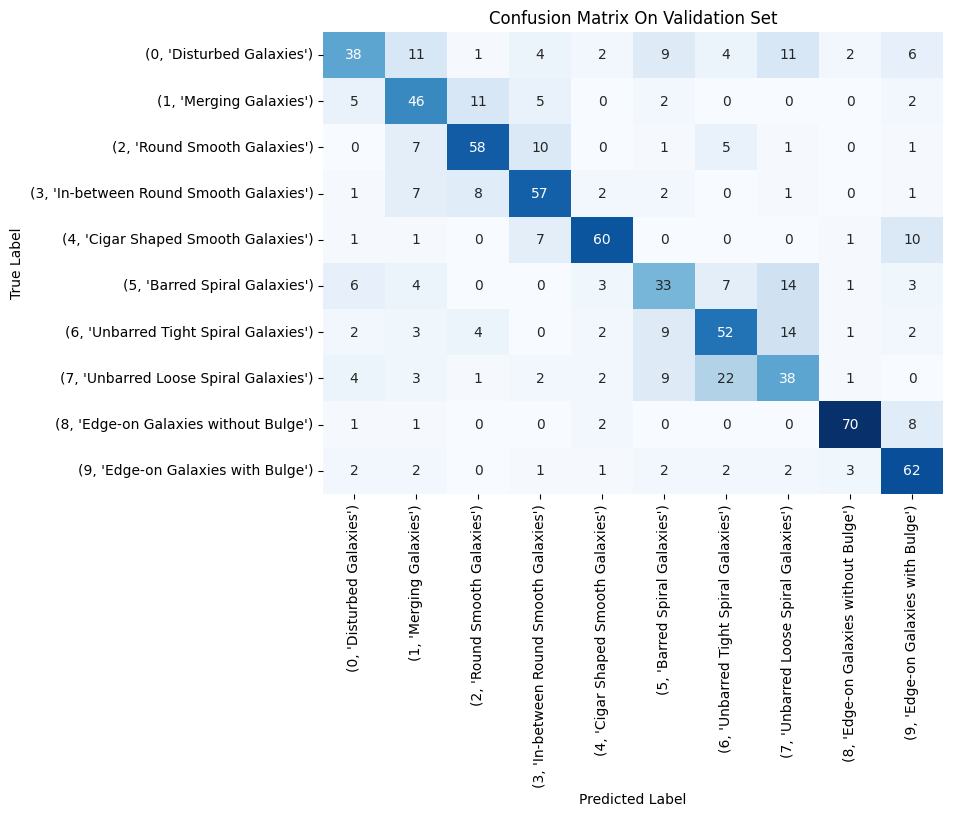

Test Set Accuracy: 0.6317
              precision    recall  f1-score   support

         0.0       0.55      0.55      0.55        66
         1.0       0.59      0.67      0.63        67
         2.0       0.71      0.73      0.72        67
         3.0       0.64      0.73      0.69        67
         4.0       0.75      0.76      0.76        67
         5.0       0.44      0.45      0.44        67
         6.0       0.57      0.52      0.55        67
         7.0       0.39      0.34      0.37        67
         8.0       0.83      0.82      0.82        66
         9.0       0.82      0.75      0.78        67

    accuracy                           0.63       668
   macro avg       0.63      0.63      0.63       668
weighted avg       0.63      0.63      0.63       668



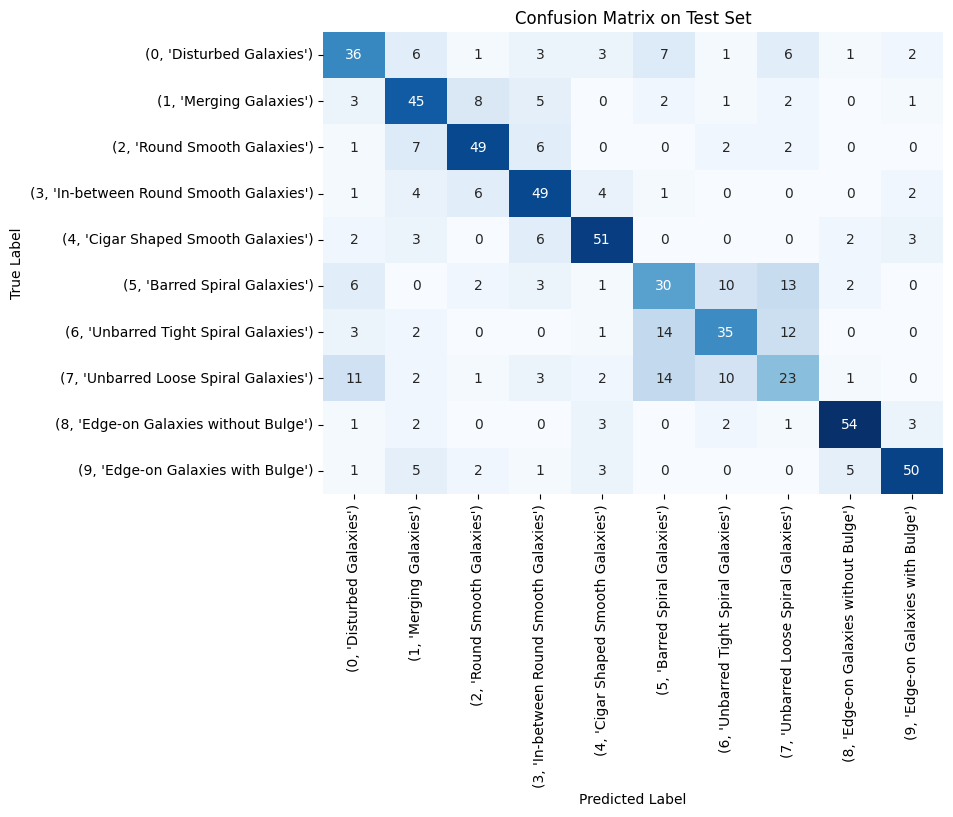

Running time/train pred time/val pred time/test pred time 29.586043572000108 0.25303641200025595 0.12572187500018117 0.12004736099970614


In [51]:
logreg_y_val_pred = record_time_and_run_model(model_logreg, X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test)

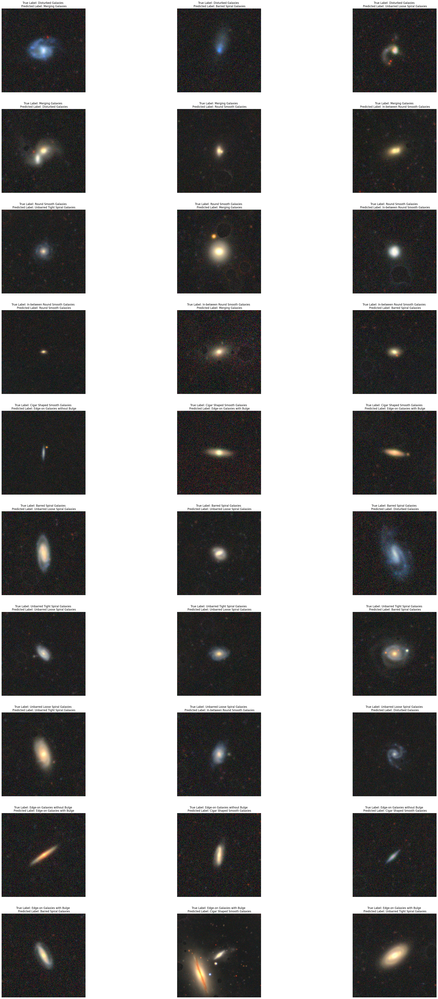

In [79]:
fig, ax = plt.subplots(10,3, figsize = (40,80))
for clss in np.unique(y_val).astype(int):
    our_inds = np.argwhere(y_val == clss)
    our_pred_inds = np.argwhere(logreg_y_val_pred!= clss)
    our_inds = np.intersect1d(our_inds, our_pred_inds)
    our_true_labs = y_val[our_inds]
    our_pred_labs = logreg_y_val_pred[our_inds]
    our_imgs = X_val[our_inds]
    for i in range(3):
        ax[clss][i].imshow(our_imgs[i]/255, cmap = 'hsv')
        ax[clss][i].set_title(f"True Label: {label_dict[our_true_labs[i]]} \n Predicted Label: {label_dict[our_pred_labs[i]]}")
        ax[clss][i].axis('off')

Training Set Accuracy: 0.9353
Validation Set Accuracy: 0.6035


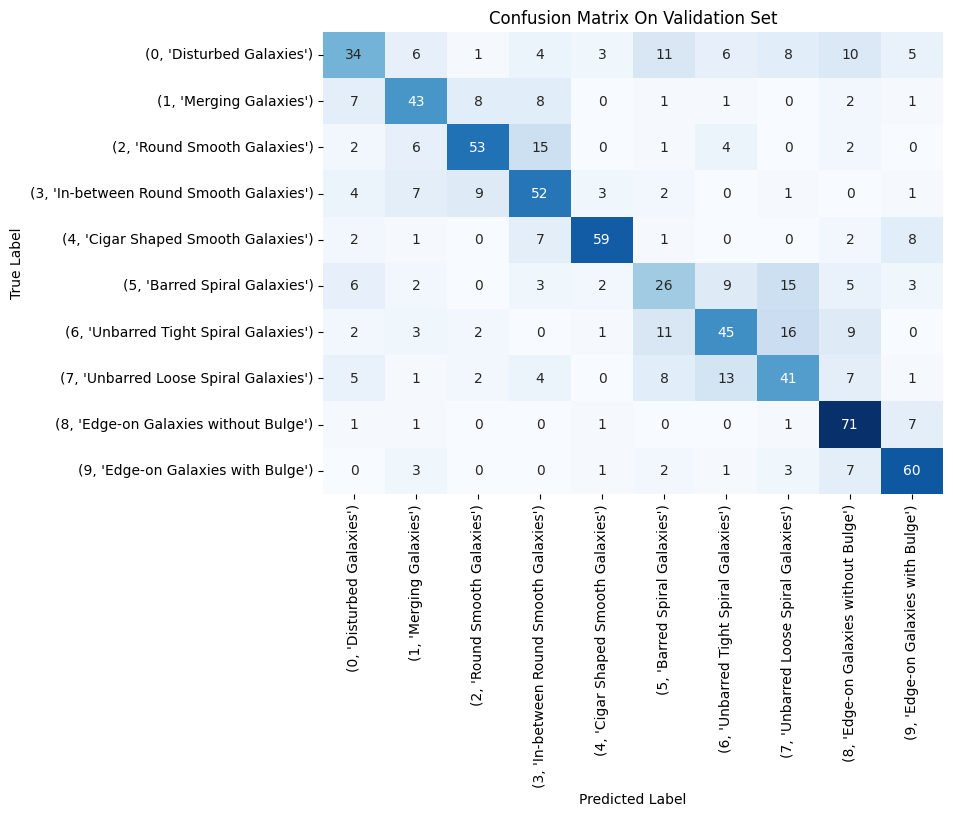

Test Set Accuracy: 0.6138
              precision    recall  f1-score   support

         0.0       0.53      0.52      0.52        66
         1.0       0.63      0.64      0.64        67
         2.0       0.69      0.63      0.66        67
         3.0       0.67      0.75      0.70        67
         4.0       0.83      0.73      0.78        67
         5.0       0.40      0.39      0.39        67
         6.0       0.55      0.48      0.51        67
         7.0       0.42      0.37      0.40        67
         8.0       0.60      0.88      0.72        66
         9.0       0.81      0.76      0.78        67

    accuracy                           0.61       668
   macro avg       0.61      0.61      0.61       668
weighted avg       0.61      0.61      0.61       668



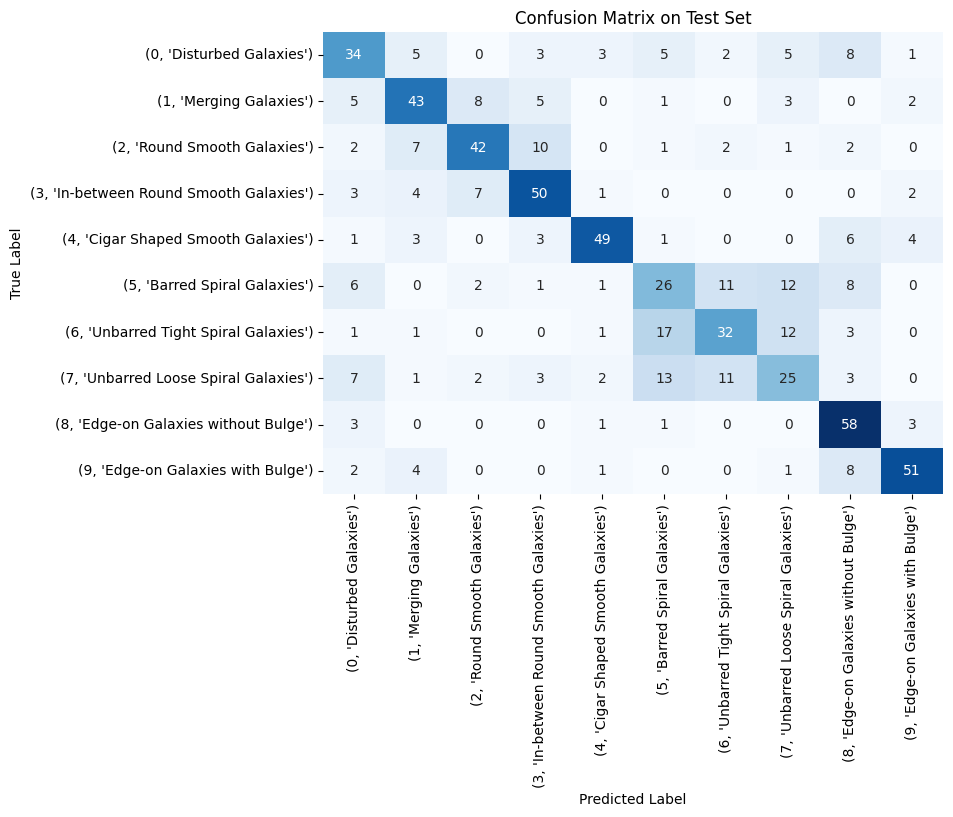

Running time/train pred time/val pred time/test pred time 4.2613435299999765 0.20438802700027736 0.14798016899976574 0.1405469319997792


In [82]:
svm_yval_pred = record_time_and_run_model(model_svm, X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test)

Training Set Accuracy: 0.9706
Validation Set Accuracy: 0.5761


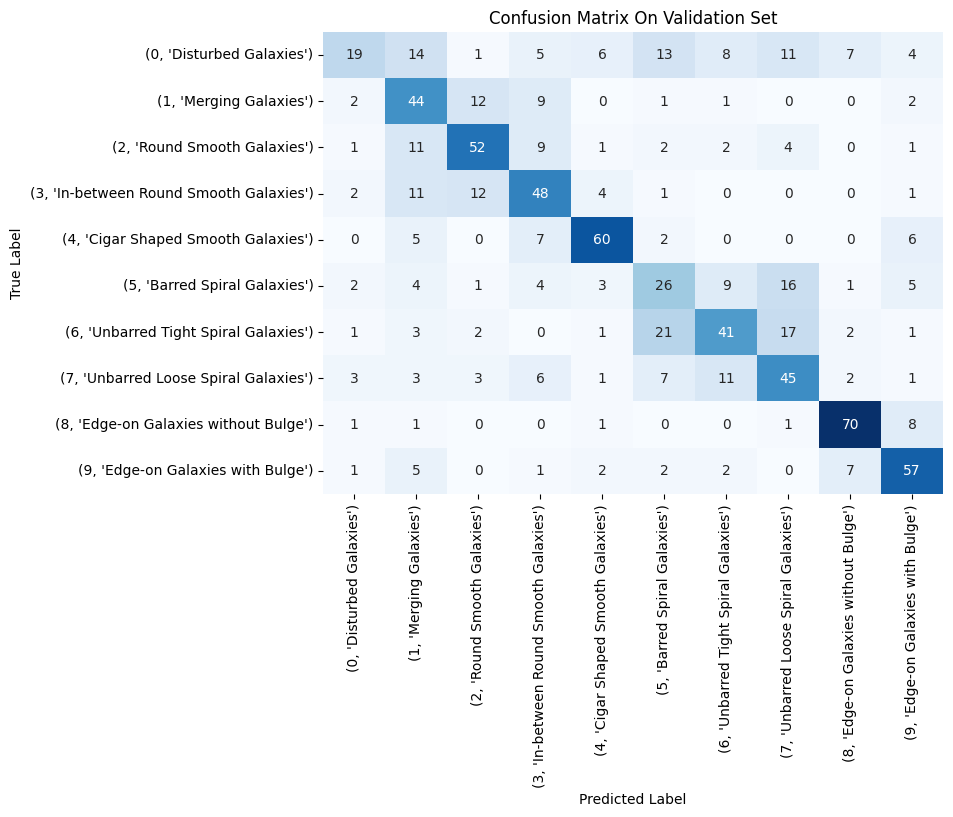

Test Set Accuracy: 0.5689
              precision    recall  f1-score   support

         0.0       0.53      0.15      0.24        66
         1.0       0.50      0.61      0.55        67
         2.0       0.65      0.72      0.68        67
         3.0       0.52      0.67      0.59        67
         4.0       0.69      0.70      0.70        67
         5.0       0.44      0.52      0.48        67
         6.0       0.48      0.48      0.48        67
         7.0       0.36      0.30      0.33        67
         8.0       0.78      0.76      0.77        66
         9.0       0.71      0.78      0.74        67

    accuracy                           0.57       668
   macro avg       0.57      0.57      0.55       668
weighted avg       0.57      0.57      0.55       668



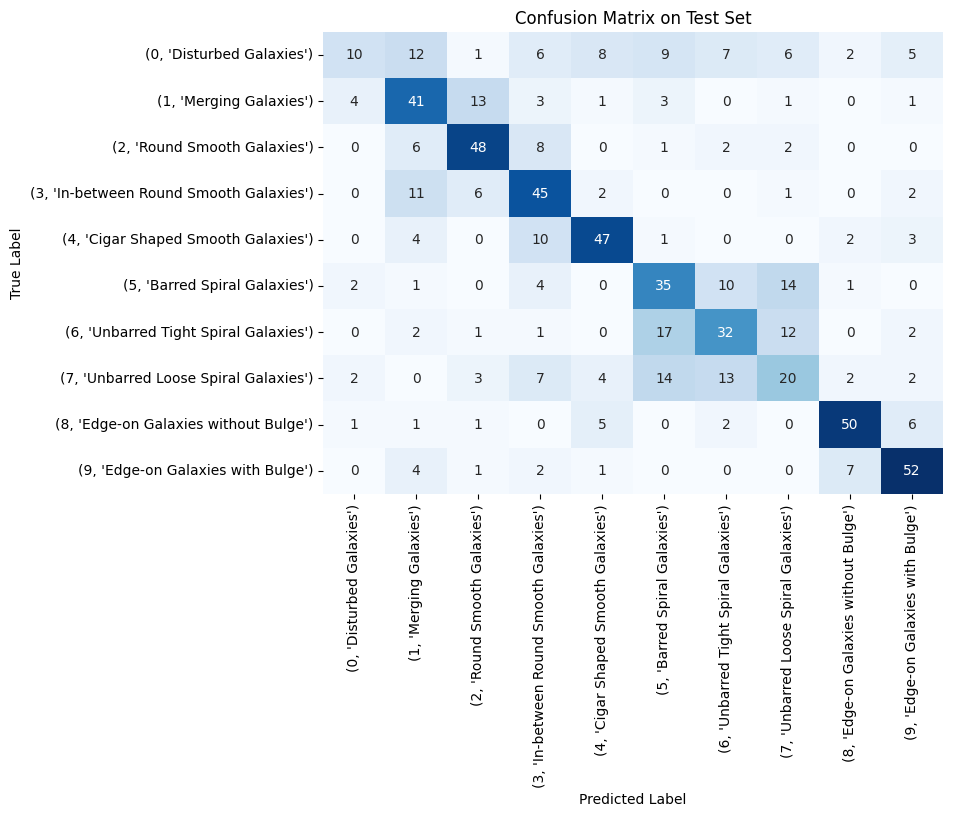

Running time/train pred time/val pred time/test pred time 4.4379456340002434 0.10812731600026382 0.05681290499978786 0.04972889100008615


In [92]:
rf_yval_pred = record_time_and_run_model(model_rf, X_train_scaled, y_train, X_val_scaled, y_val, X_test_scaled, y_test)

# Efficiency/Accuracy Trade-Off
In our case, all models have issue of overfitting.
Try consolidate everything into one PCA.

In [21]:
feature_labels = ['Mean Color Channel', 'Center Color Channel', 'HOG', 'BOVW', 'ResNet']

In [22]:
# consolidated PCA
consolidated_train_feats = np.concatenate(train_features, axis = -1)
consolidated_val_feats = np.concatenate(val_features, axis = -1)
con_n_components = 28 #number source see PCA Analysis

# convert to PCA and standarize
con_scaler, con_X_train_scaled, con_X_val_scaled, con_X_pca, con_X_fit_pca_list = transform_to_PCA_vectors([consolidated_train_feats],
                                                        [consolidated_val_feats],
                                                        ['Consolidated PCA'], [],
                                                        components_dict = {'Consolidated PCA': con_n_components})

In [23]:
X_test_features, feature_labels  = get_features(X_test)
consolidated_test_feats = np.concatenate(X_test_features, axis = -1)

# trainsform test set to PCA
X_test_pca = []
X_test_pca.append(con_X_fit_pca_list[0].transform(consolidated_test_feats))

X_test_pca = build_feature_vector(X_test_pca)
X_test_scaled = con_scaler.transform(X_test_pca)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet101_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [24]:
con_X_train_scaled.shape, con_X_val_scaled.shape, X_test_scaled.shape

((1870, 28), (802, 28), (668, 28))

In [25]:
len(y_train), len(y_val), len(y_test)

(1870, 802, 668)

In [26]:
def create_final_logreg_model(input_dim):
    model = Sequential()
    model.add(Dense(10, input_dim=input_dim, activation='softmax', kernel_regularizer=l2(0.01)))
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model


model_svm = SVC(C=1, kernel='rbf', gamma = 'auto')

model_rf = RandomForestClassifier(random_state = random_state,
                                  n_estimators = 300,
                                  max_depth = 8)

model_logreg = model = KerasClassifier(model=create_final_logreg_model,
                                input_dim=con_X_train_scaled.shape[1],
                                batch_size=20,
                                epochs = 100,
                                verbose=0)


Training Set Accuracy: 0.7701
Validation Set Accuracy: 0.4838


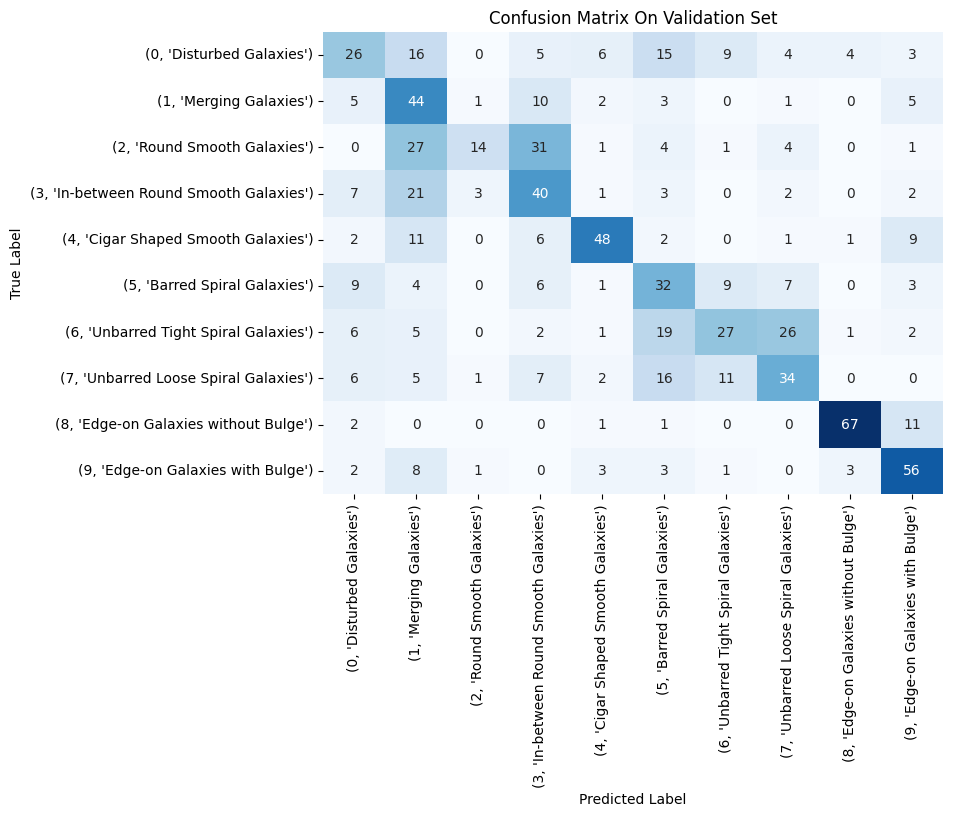

Test Set Accuracy: 0.4895
              precision    recall  f1-score   support

         0.0       0.28      0.20      0.23        66
         1.0       0.36      0.64      0.46        67
         2.0       0.66      0.28      0.40        67
         3.0       0.42      0.52      0.46        67
         4.0       0.58      0.54      0.56        67
         5.0       0.40      0.54      0.46        67
         6.0       0.48      0.43      0.46        67
         7.0       0.37      0.25      0.30        67
         8.0       0.80      0.74      0.77        66
         9.0       0.74      0.75      0.74        67

    accuracy                           0.49       668
   macro avg       0.51      0.49      0.48       668
weighted avg       0.51      0.49      0.48       668



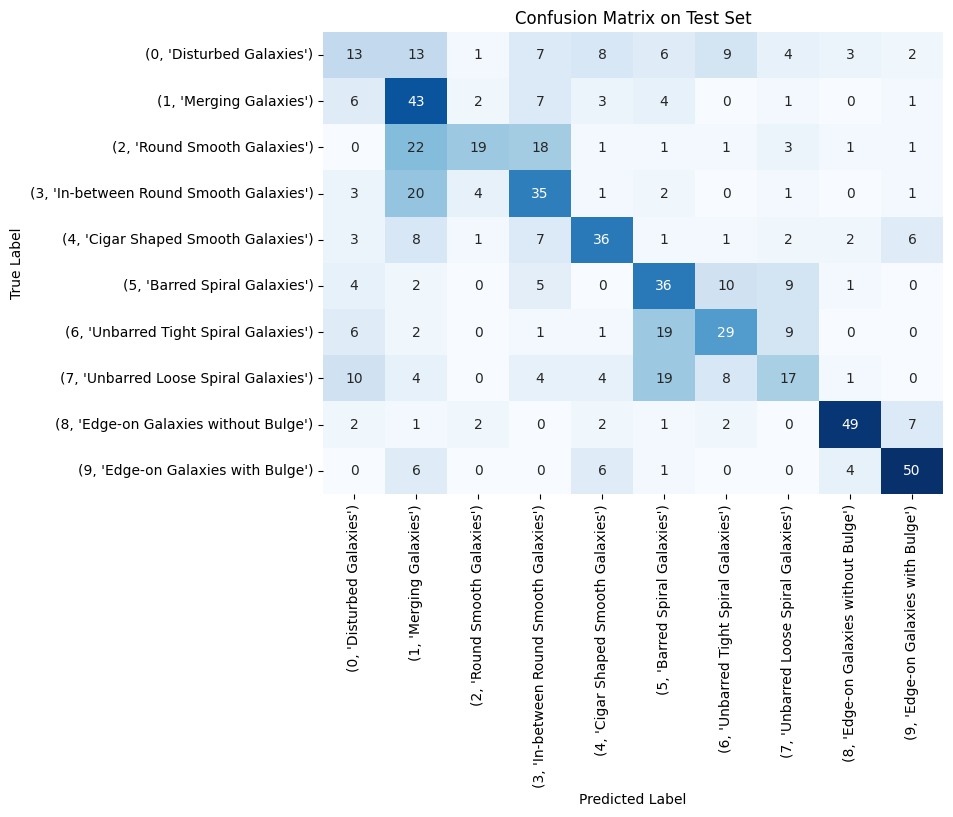

Running time/train pred time/val pred time/test pred time 3.6925052300000516 0.42774677600004907 0.09794408300012947 0.17690236299995377


In [29]:
record_time_and_run_model(model_svm, con_X_train_scaled, y_train, con_X_val_scaled, y_val, X_test_scaled, y_test)

Training Set Accuracy: 0.6037
Validation Set Accuracy: 0.4676


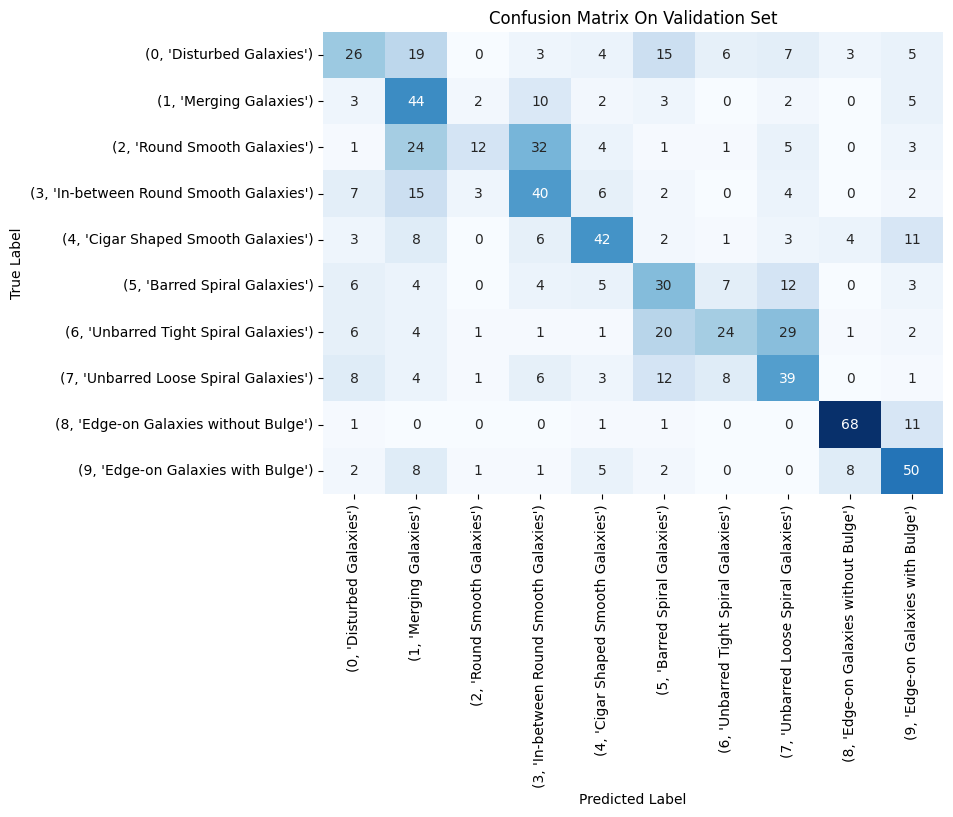

Test Set Accuracy: 0.4671
              precision    recall  f1-score   support

         0.0       0.27      0.20      0.23        66
         1.0       0.35      0.58      0.44        67
         2.0       0.58      0.31      0.41        67
         3.0       0.41      0.55      0.47        67
         4.0       0.56      0.43      0.49        67
         5.0       0.36      0.45      0.40        67
         6.0       0.47      0.34      0.40        67
         7.0       0.31      0.28      0.29        67
         8.0       0.76      0.79      0.78        66
         9.0       0.71      0.73      0.72        67

    accuracy                           0.47       668
   macro avg       0.48      0.47      0.46       668
weighted avg       0.48      0.47      0.46       668



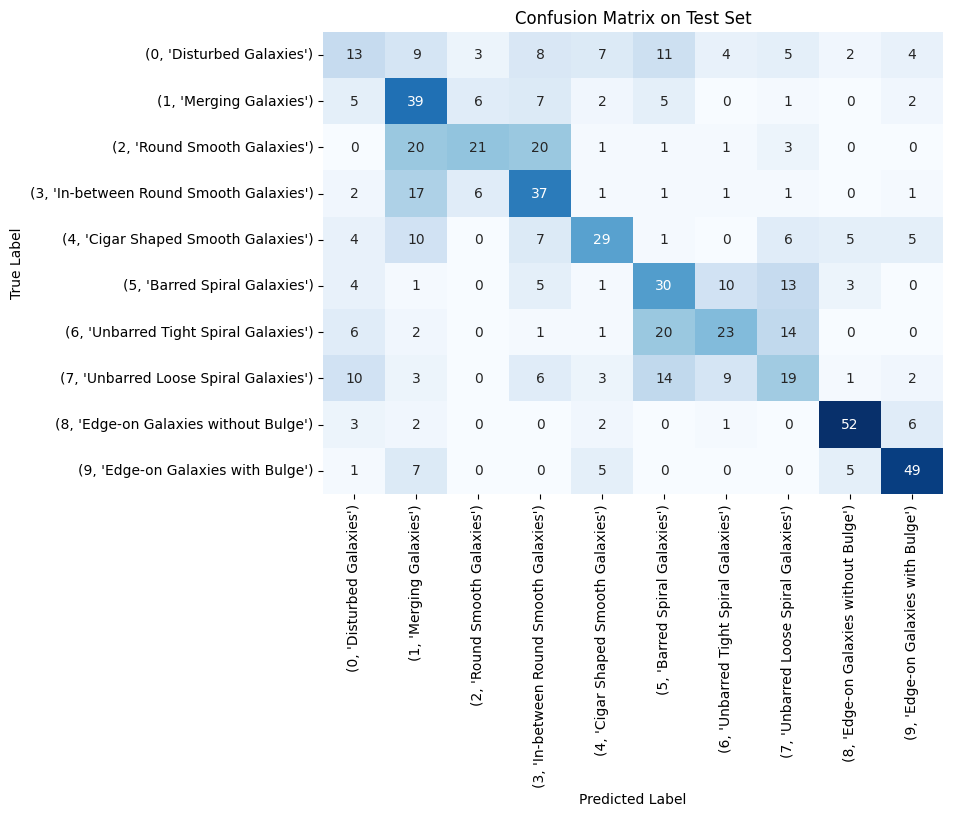

Running time/train pred time/val pred time/test pred time 27.510456140000088 0.294541585999923 0.14783179500000188 0.13615515000014966


In [30]:
record_time_and_run_model(model_logreg, con_X_train_scaled, y_train, con_X_val_scaled, y_val, X_test_scaled, y_test)

Training Set Accuracy: 0.8701
Validation Set Accuracy: 0.4414


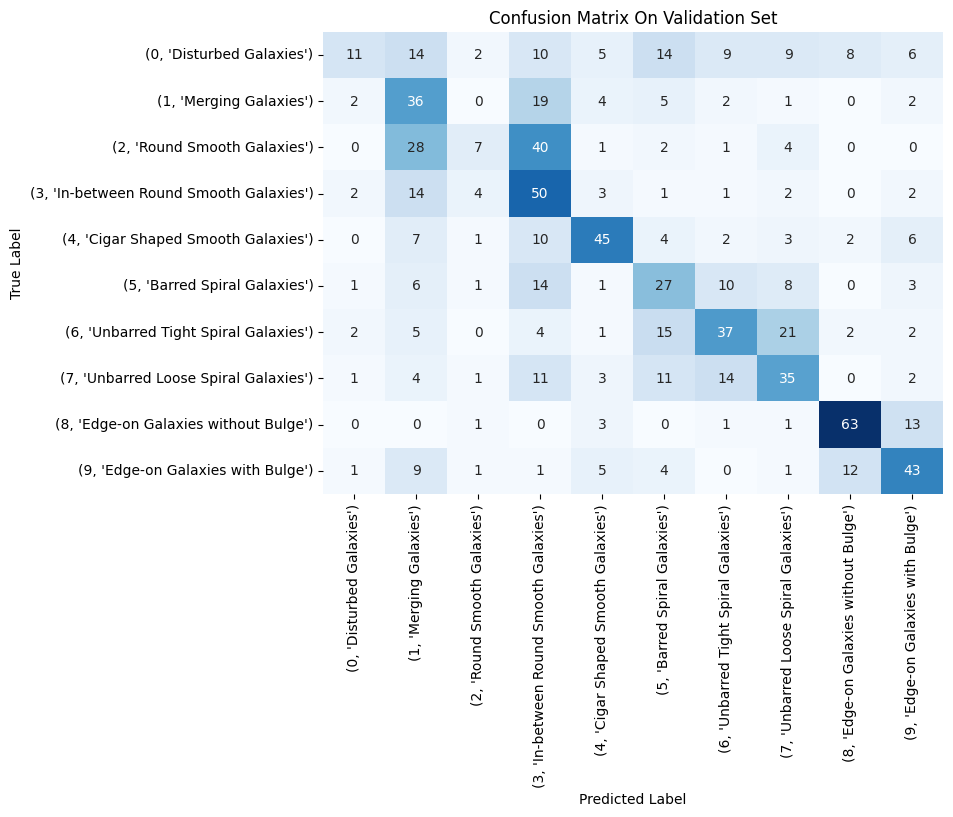

Test Set Accuracy: 0.4237
              precision    recall  f1-score   support

         0.0       0.23      0.05      0.08        66
         1.0       0.34      0.51      0.40        67
         2.0       0.34      0.21      0.26        67
         3.0       0.31      0.63      0.42        67
         4.0       0.54      0.40      0.46        67
         5.0       0.35      0.45      0.39        67
         6.0       0.42      0.45      0.43        67
         7.0       0.41      0.33      0.36        67
         8.0       0.73      0.65      0.69        66
         9.0       0.66      0.57      0.61        67

    accuracy                           0.42       668
   macro avg       0.43      0.42      0.41       668
weighted avg       0.43      0.42      0.41       668



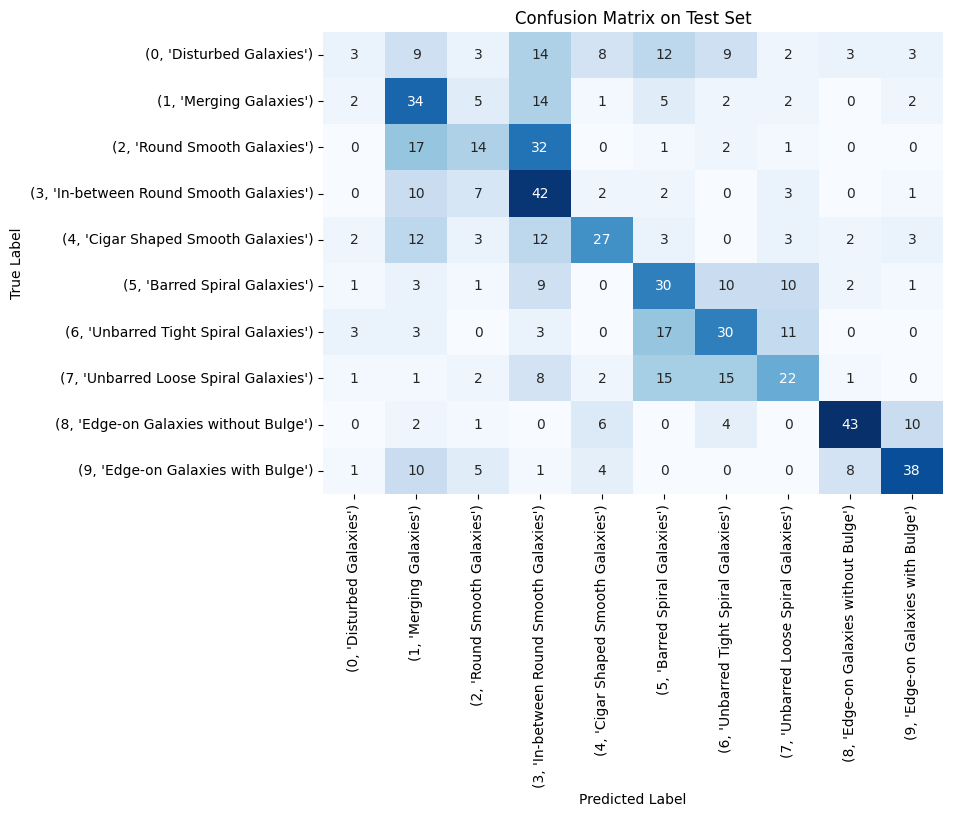

Running time/train pred time/val pred time/test pred time 2.0062255919999643 0.09360257599996658 0.0468088089999128 0.04280071400012275


In [31]:
record_time_and_run_model(model_rf, con_X_train_scaled, y_train, con_X_val_scaled, y_val, X_test_scaled, y_test)

# Find the best model

In [50]:
import time
import warnings
warnings.filterwarnings('default')

In [110]:
comb_of_features = [
    ['Mean Color Channel','Center Color Channel', 'ResNet'],
    #['Mean Color Channel', 'HOG', 'BOVW'],
    #['Mean Color Channel', 'HOG', 'ResNet'],
    #['Mean Color Channel', 'HOG', 'BOVW', 'ResNet'],
    #['Mean Color Channel','Center Color Channel', 'BOVW', 'ResNet'],
    #['Mean Color Channel','Center Color Channel', 'HOG', 'BOVW', 'ResNet'] #original feature set
]
model_type_list = ['SVM', 'RF', 'LogReg']
#model_type_list = ['SVM']

In [ ]:
#Initialize record dfs
column_features = []
column_models = []
column_param_tune_time = []
column_train_pred_time = []
column_val_pred_time = []
column_test_pred_time = []
best_model_lists = []
grid_search_results_lists = []

start running combination SVM model and features ['Mean Color Channel', 'Center Color Channel', 'ResNet']
SVM Training Set Accuracy: 0.9374
SVM Validation Set Accuracy: 0.6072


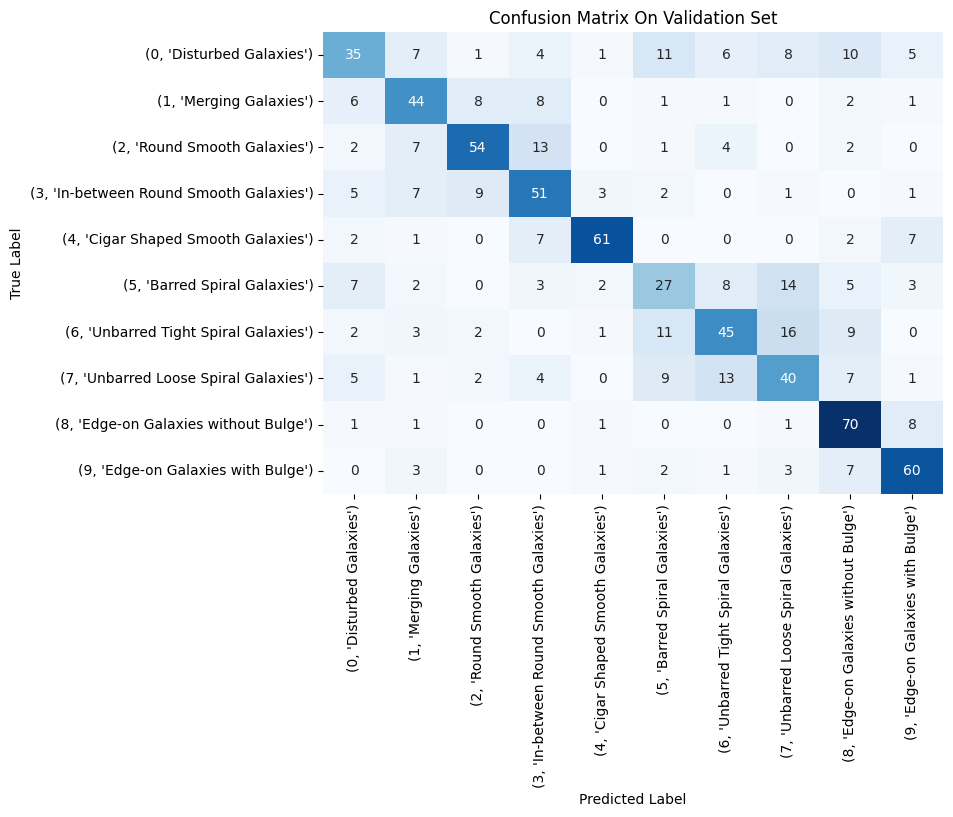

Best Hyperparameters for SVM: {'C': 1, 'gamma': 'auto', 'kernel': 'rbf'}
Test Set Accuracy: 0.6153
              precision    recall  f1-score   support

         0.0       0.52      0.52      0.52        66
         1.0       0.63      0.64      0.64        67
         2.0       0.72      0.63      0.67        67
         3.0       0.66      0.76      0.71        67
         4.0       0.85      0.75      0.79        67
         5.0       0.39      0.39      0.39        67
         6.0       0.56      0.48      0.52        67
         7.0       0.41      0.36      0.38        67
         8.0       0.60      0.88      0.72        66
         9.0       0.81      0.76      0.78        67

    accuracy                           0.62       668
   macro avg       0.62      0.62      0.61       668
weighted avg       0.62      0.62      0.61       668



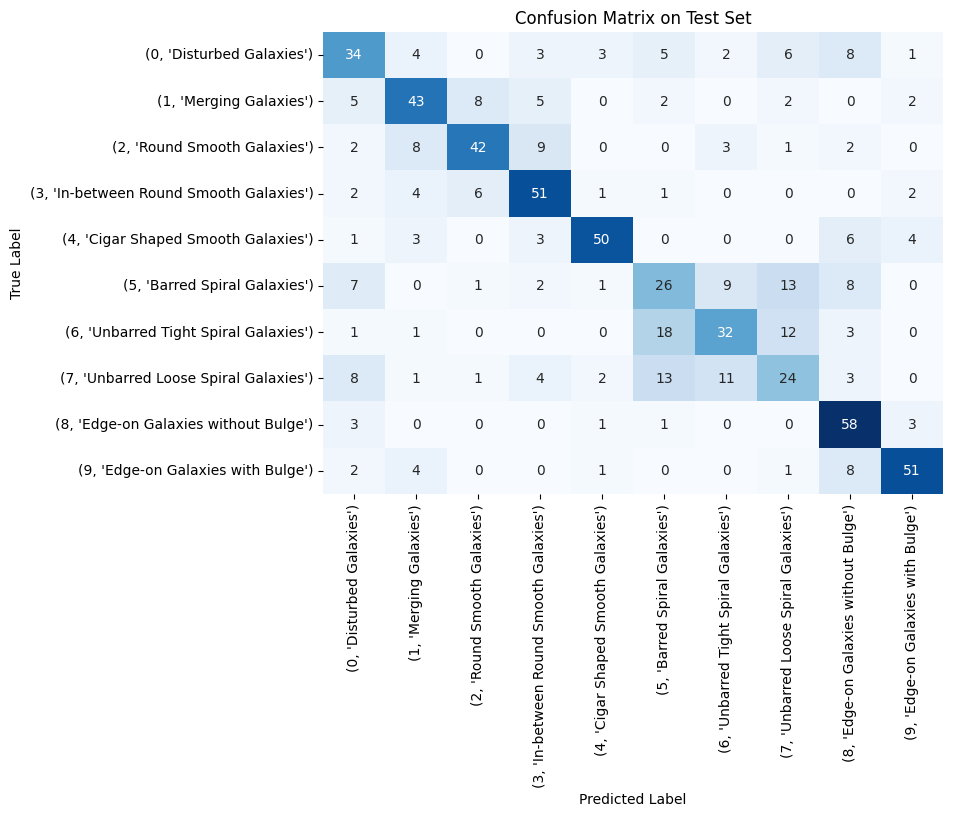

start running combination RF model and features ['Mean Color Channel', 'Center Color Channel', 'ResNet']
RF Training Set Accuracy: 0.9759
RF Validation Set Accuracy: 0.5723


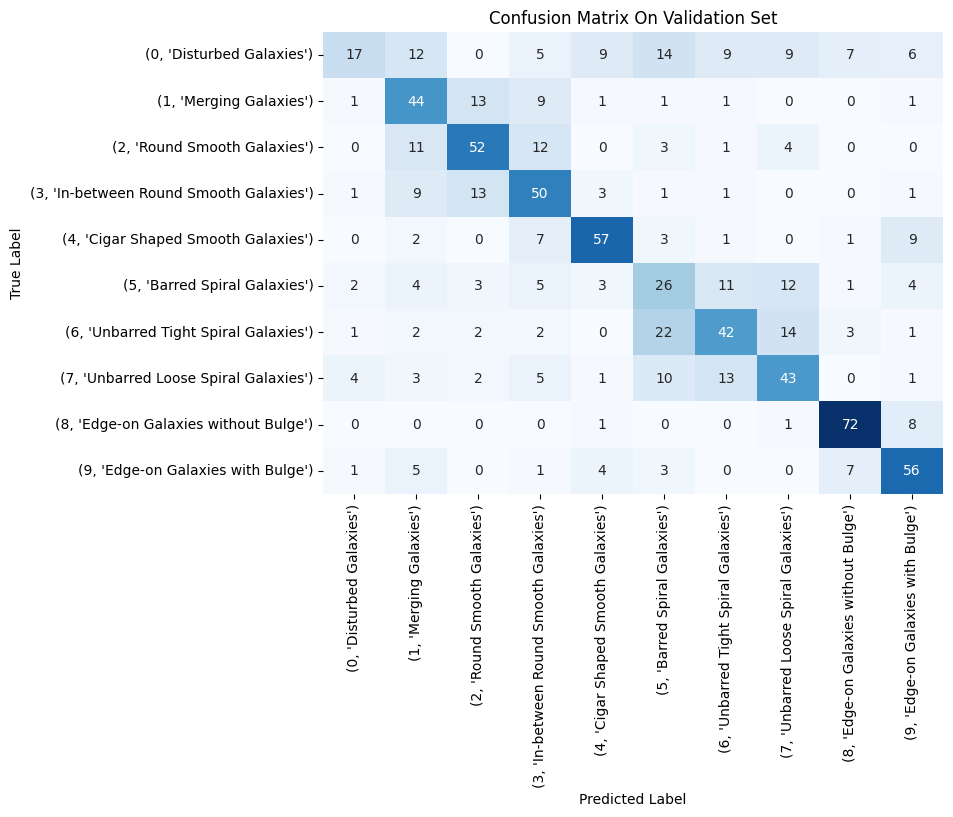

Best Hyperparameters for RF: {'max_depth': 8, 'n_estimators': 300, 'split_criterion': 0}
Test Set Accuracy: 0.5793
              precision    recall  f1-score   support

         0.0       0.61      0.21      0.31        66
         1.0       0.52      0.64      0.58        67
         2.0       0.63      0.72      0.67        67
         3.0       0.54      0.60      0.57        67
         4.0       0.65      0.72      0.68        67
         5.0       0.46      0.55      0.50        67
         6.0       0.53      0.45      0.48        67
         7.0       0.33      0.30      0.31        67
         8.0       0.79      0.80      0.80        66
         9.0       0.73      0.81      0.77        67

    accuracy                           0.58       668
   macro avg       0.58      0.58      0.57       668
weighted avg       0.58      0.58      0.57       668



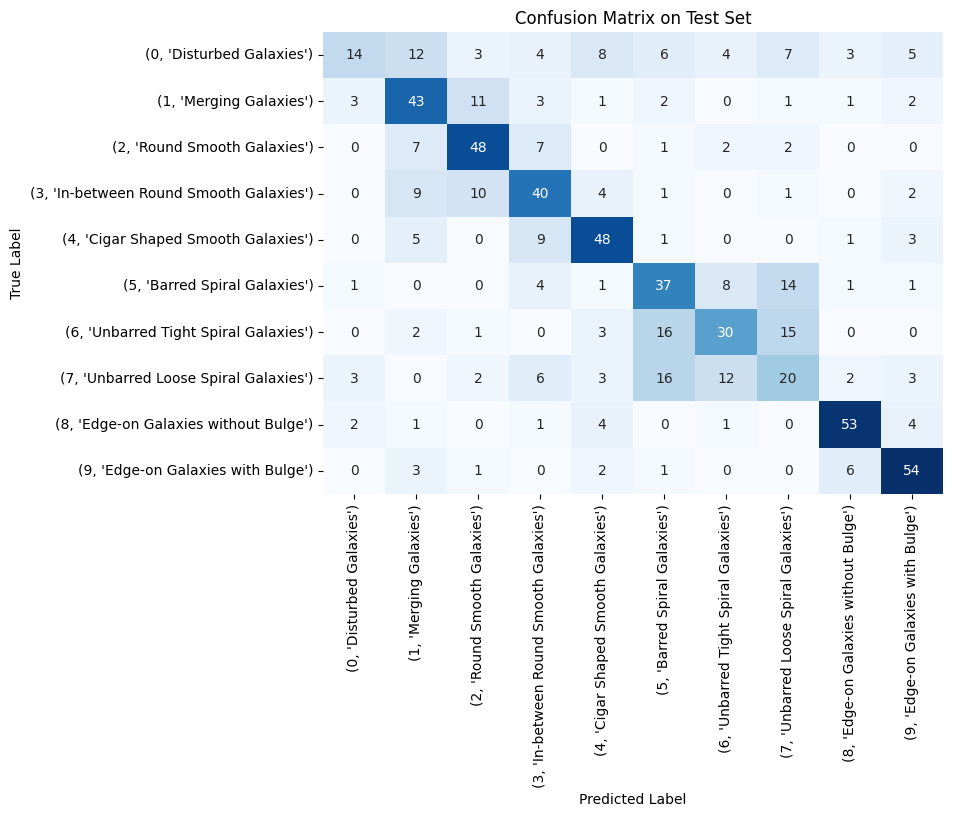

start running combination LogReg model and features ['Mean Color Channel', 'Center Color Channel', 'ResNet']
LogReg Training Set Accuracy: 0.8150
LogReg Validation Set Accuracy: 0.6459


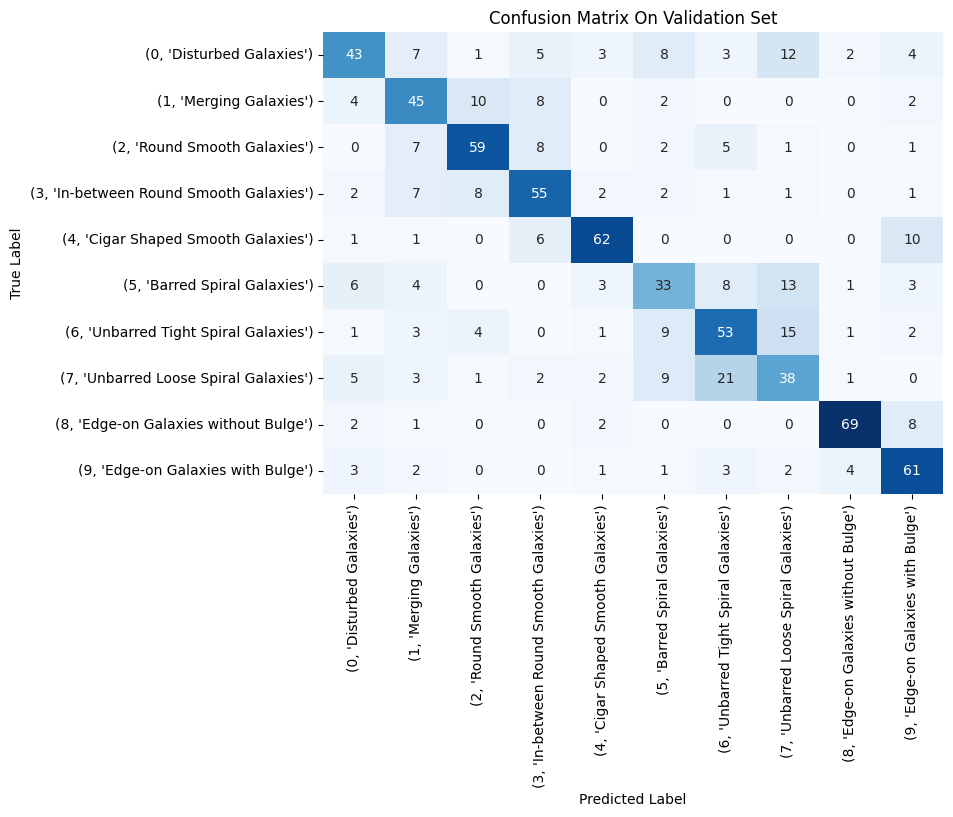

Best Hyperparameters for LogReg: {'epochs': 200, 'model__kernel_regularizer': <keras.src.regularizers.L2 object at 0x7c977e2d21d0>, 'model__optimizer': <keras.src.optimizers.sgd.SGD object at 0x7c96eee95390>}
Test Set Accuracy: 0.6257
              precision    recall  f1-score   support

         0.0       0.56      0.56      0.56        66
         1.0       0.59      0.63      0.61        67
         2.0       0.70      0.73      0.72        67
         3.0       0.65      0.75      0.69        67
         4.0       0.75      0.76      0.76        67
         5.0       0.44      0.48      0.46        67
         6.0       0.56      0.51      0.53        67
         7.0       0.40      0.34      0.37        67
         8.0       0.81      0.77      0.79        66
         9.0       0.78      0.73      0.75        67

    accuracy                           0.63       668
   macro avg       0.62      0.63      0.62       668
weighted avg       0.62      0.63      0.62       668



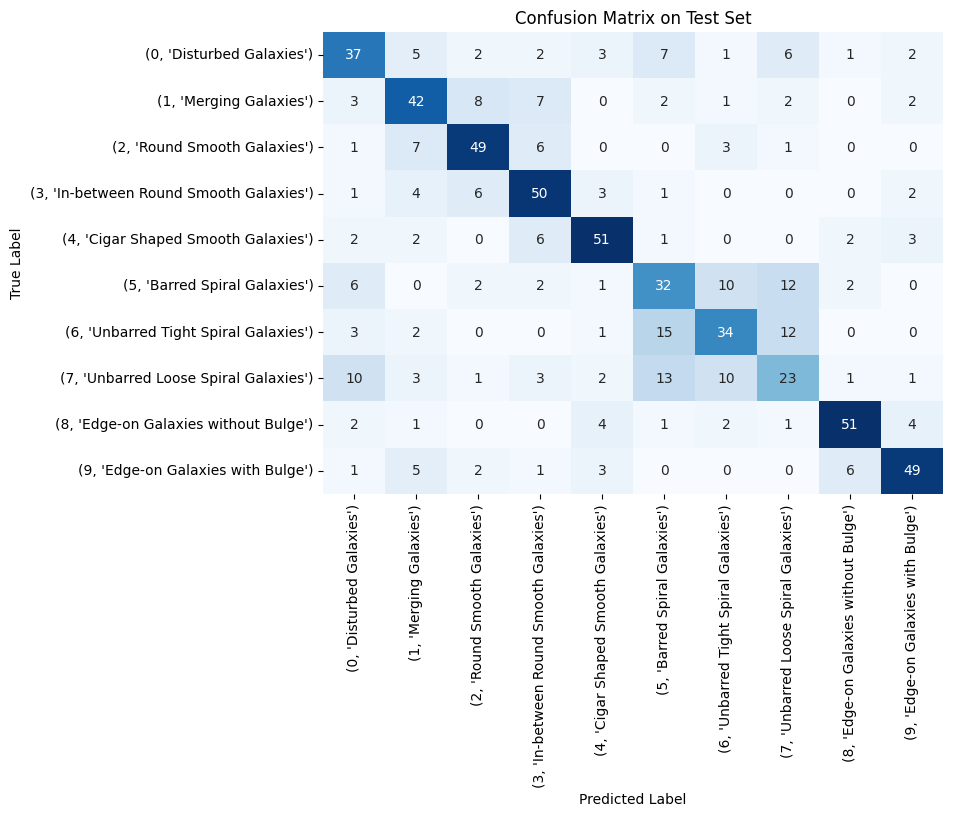

In [111]:
#start loop to find best feature & model combination
for select_feature in comb_of_features:
    # convert to PCA and standarize
    scaler, X_train_scaled, X_val_scaled, X_pca, X_fit_pca_list = transform_to_PCA_vectors(train_features,
                                                                                           val_features,
                                                            feature_labels, select_feature)
    for mod_type in model_type_list:
        print(f'start running combination {mod_type} model and features {str(select_feature)}')
        column_features.append(select_feature)
        column_models.append(mod_type)

        # start process and record all kinds of time
        start = time.process_time()

        best_model, cv_results_df, train_pred_time, val_pred_time = grid_search([X_train_scaled, X_val_scaled],
                                                [y_train, y_val],
                                                model_type = mod_type)
        stop = time.process_time()
        duration = stop - start
        column_param_tune_time.append(duration)

        best_model_lists.append(best_model)
        grid_search_results_lists.append(cv_results_df)
        column_train_pred_time.append(train_pred_time)
        column_val_pred_time.append(val_pred_time)

        _,_,test_pred_time = plot_confusion(X_pca, scaler, best_model,
                                            X_fit_pca_list, X_test, y_test,
                                            select_feature, model_type=mod_type)

        column_test_pred_time.append(test_pred_time)


In [114]:
data = {
        'Features': column_features,
        'Models': column_models,
        'Param_Tune_Time': column_param_tune_time,
        'Train_Prediction_Time': column_train_pred_time,
        'Validation_Prediction_Time': column_val_pred_time,
        'Test_Prediction_Time': column_test_pred_time
    }

df = pd.DataFrame(data)
df

,Features,Models,Param_Tune_Time,Train_Prediction_Time,Validation_Prediction_Time,Test_Prediction_Time
0,"[Mean Color Channel, Center Color Channel, Res...",SVM,734.713545,0.202393,0.145235,0.706385
1,"[Mean Color Channel, HOG, BOVW]",SVM,853.542806,0.320918,0.254447,1.052727
2,"[Mean Color Channel, HOG, ResNet]",SVM,834.737944,0.314024,0.249080,1.240136
3,"[Mean Color Channel, HOG, BOVW, ResNet]",SVM,945.966573,0.375220,0.291107,1.094515
4,"[Mean Color Channel, Center Color Channel, BOV...",SVM,838.759590,0.252328,0.210666,0.911721
5,"[Mean Color Channel, Center Color Channel, Res...",LogReg,2997.741461,0.269456,0.137490,0.962741
6,"[Mean Color Channel, Center Color Channel, BOV...",LogReg,2971.739860,0.255906,0.135418,0.763739
7,"[Mean Color Channel, Center Color Channel, HoG...",LogReg,3085.086522,0.259371,0.134617,0.912433
8,"[Mean Color Channel, Center Color Channel, Res...",RF,659.007878,0.136319,0.079321,1.357759
9,"[Mean Color Channel, HOG, ResNet]",RF,855.960672,0.236375,0.193946,1.061181


In [115]:
df.to_csv('results_all.csv')